This code is the LSTM prediction for next location of taxi given previous 50 points of location. 
Some portions of this code were generated with ChatGPT (OpenAI, 2023)

References:
OpenAI. (2023). ChatGPT (Mar 14 version) [Large language model]. https://chat.openai.com/chat


In [3]:
# uncomment for google colab
#from google.colab import drive
#drive.mount('/content/drive')
#drive_path = '/content/drive/My Drive/'
drive_path = 'taxi_trajectories/'

In [6]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from sklearn.model_selection import train_test_split
import ast
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns
import joblib

In [11]:
file_path =  drive_path + "cleaned_taxi_data.csv"
df = pd.read_csv(file_path)

#Convert TIMESTAMP to datetime
df['TIMESTAMP'] = pd.to_datetime(df['TIMESTAMP'])

#Extract time-based features
df['HOUR'] = df['TIMESTAMP'].dt.hour
df['DAY_OF_WEEK'] = df['TIMESTAMP'].dt.dayofweek
df['MONTH'] = df['TIMESTAMP'].dt.month

#Convert POLYLINE (GPS coordinates) from string to list
df['POLYLINE'] = df['POLYLINE'].apply(lambda x: ast.literal_eval(x) if isinstance(x, str) else x)

#Remove trips with no GPS data
df = df[df['POLYLINE'].apply(len) > 0]

#Normalize GPS coordinates
scaler = MinMaxScaler()
all_coords = np.vstack(df['POLYLINE'])
scaler.fit(all_coords)

#Function to create LSTM input sequences
def create_sequences_location(data, indices, seq_length=50):
    X, y, original_indices = [], [], []
    for idx, trip in zip(indices, data):
        trip = scaler.transform(trip)  # Normalize coordinates
        if len(trip) > seq_length:
            for i in range(len(trip) - seq_length):
                X.append(trip[i:i+seq_length])  # 50 GPS points as input
                y.append(trip[i+seq_length])    # Next coordinate as output
                original_indices.append(idx)   # Store the original DataFrame index
    return np.array(X), np.array(y), np.array(original_indices)

#Prepare LSTM dataset
X, y, seq_indices = create_sequences_location(df['POLYLINE'].values, indices=df.index, seq_length=50)

# Save preprocessed dataset (optional)
np.save(drive_path + "/X_sequences.npy", X)
np.save(drive_path + "/y_targets.npy", y)
np.save(drive_path + "/seq_indices.npy", seq_indices)

Here is the first iteration of the LSTM, with 200,000 random samples pulled from the nearly 2,000,000 rows of data. The processing needs were too great so as a team we decided on 200,000. The graphic below shows quick learning and reinforces that the LSTM was a good choice for this application.

Final X_train shape: (160000, 50, 2)
Final X_test shape: (40000, 50, 2)
Final y_train shape: (160000, 2)
Final y_test shape: (40000, 2)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 17s 10ms/step - loss: 0.0052 - mae: 0.0361 - val_loss: 1.5790e-05 - val_mae: 0.0028
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - loss: 1.7786e-05 - mae: 0.0031 - val_loss: 8.9041e-06 - val_mae: 0.0020
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 21s 11ms/step - loss: 9.7338e-06 - mae: 0.0023 - val_loss: 8.7191e-06 - val_mae: 0.0020
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - loss: 8.5361e-06 - mae: 0.0021 - val_loss: 7.3213e-06 - val_mae: 0.0019
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 21s 10ms/step - loss: 6.6080e-06 - mae: 0.0019 - val_loss: 4.2735e-06 - val_mae: 0.0014
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step - loss: 5.0152e-06 - mae: 0.0016 - val_loss: 3.1088e-06 - val_mae: 0.0013
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 20s 11ms/step - loss: 4.4896e-06 - mae: 0.0015 - val_loss: 2.5420e-06 - val_mae: 0.0012
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - loss: 3.6881e-06 - mae: 0.0014 - val_

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 1.7677e-06 - mae: 8.8675e-04
Test Loss (MSE): 1.7817753814597381e-06
Test MAE: 0.0008858236251398921


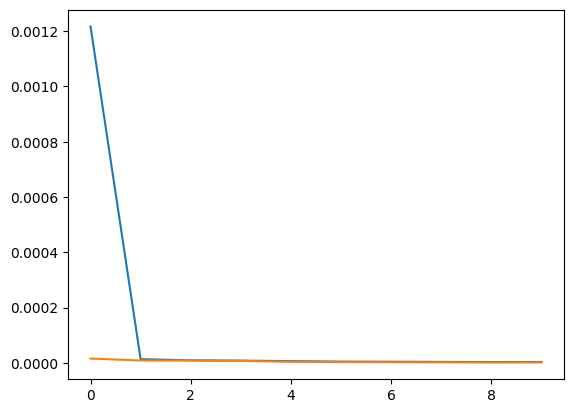

In [ ]:
X = np.load(drive_path + "/X_sequences.npy")  # (9144129, 50, 2)
y = np.load(drive_path + "/y_targets.npy")    # (9144129, 2)

#Setting seed for reproducability
np.random.seed(42)

#Sample 200,000 Data Points Randomly (Preserving Shape). Our previous dataset was far too large for the resources we are using.
sample_size = 200000
indices = np.random.permutation(len(X))[:sample_size]  # Randomized indices
X_sampled = X[indices]  # (200000, 50, 2)
y_sampled = y[indices]  # (200000, 2)
sampled_indices = seq_indices[indices]  # Retrieve original indices

#Train-Test Split (80-20)
# 🔹 Train-Test Split (80-20)
X_train, X_test, y_train, y_test, X_train_indices, X_test_indices = train_test_split(X_sampled, y_sampled, sampled_indices, test_size=0.2, random_state=42)

#Verify Correct Shapes Before Saving
print("Final X_train shape:", X_train.shape)  # Expected: (160000, 50, 2)
print("Final X_test shape:", X_test.shape)    # Expected: (40000, 50, 2)
print("Final y_train shape:", y_train.shape)  # Expected: (160000, 2)
print("Final y_test shape:", y_test.shape)    # Expected: (40000, 2)

#Save Processed Test Data
np.save(drive_path + "/X_test.npy", X_test)
np.save(drive_path + "/y_test.npy", y_test)

#Build LSTM Model
model = Sequential([
    LSTM(128, return_sequences=True, input_shape=(50, 2)),
    Dropout(0.2),
    LSTM(64, return_sequences=False),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dense(2)  # Predict latitude & longitude
])

#Compile Model
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

#Train Model
history = model.fit(X_train, y_train, epochs=10, batch_size=128, validation_data=(X_test, y_test))

#Save Model Correctly
model.save(drive_path + "/lstm_next_location.h5")

#Evaluate Model
test_loss, test_mae = model.evaluate(X_test, y_test)
print("Test Loss (MSE):", test_loss)
print("Test MAE:", test_mae)

#Plot Training & Validation Loss
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')


Checking the LSTM for performance through the actual versus predicted graphic. We see good approximation from the model.

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step


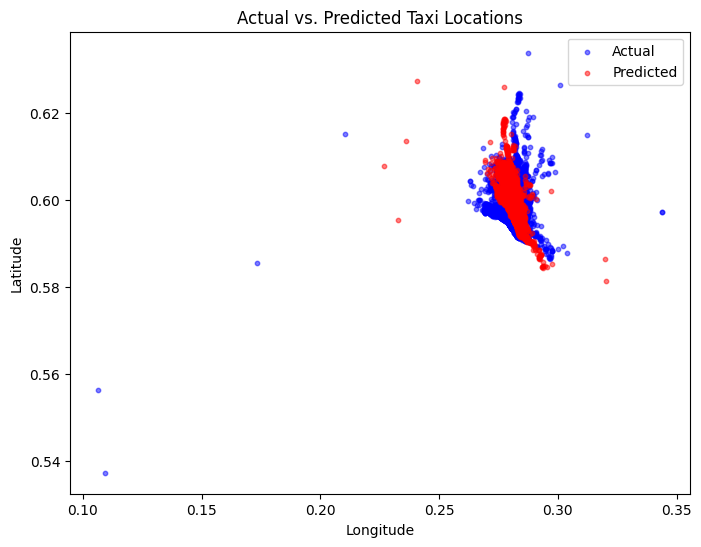

In [ ]:
#Define the custom loss function explicitly
custom_objects = {"mse": tf.keras.losses.MeanSquaredError()}

#Load the model with custom objects
model = tf.keras.models.load_model("/content/drive/My Drive/lstm_next_location.h5", custom_objects=custom_objects)

#Load Processed Test Data
X_test = np.load(drive_path + "/X_test.npy")
y_test = np.load(drive_path + "/y_test.npy")

#Make Predictions
y_pred = model.predict(X_test)

#Extract Latitude & Longitude
true_lats, true_longs = y_test[:, 0], y_test[:, 1]
pred_lats, pred_longs = y_pred[:, 0], y_pred[:, 1]

#Plot Actual vs. Predicted Taxi Locations
plt.figure(figsize=(8, 6))
plt.scatter(true_longs, true_lats, color='blue', alpha=0.5, label="Actual", s=10)
plt.scatter(pred_longs, pred_lats, color='red', alpha=0.5, label="Predicted", s=10)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Actual vs. Predicted Taxi Locations")
plt.legend()
plt.show()


Looking at errors with a bar chart.

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step


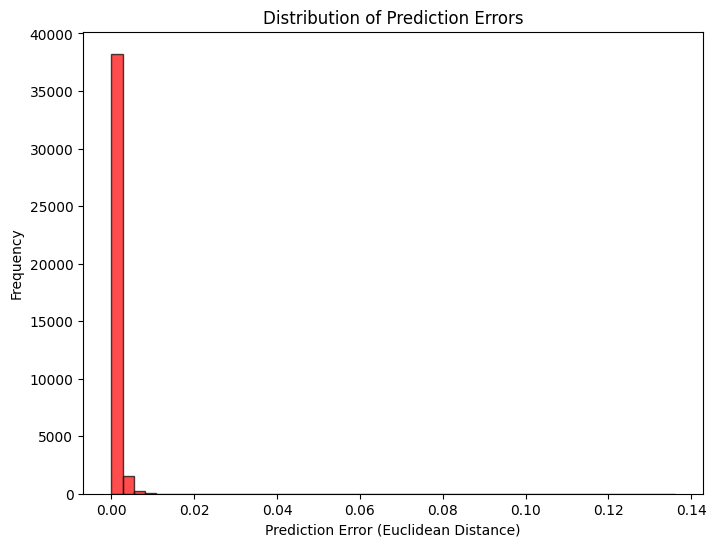

Mean Error: 0.00132
Median Error: 0.00117
Max Error: 0.13608
Min Error: 0.00000


In [ ]:
#Load Test Data
X_test = np.load(drive_path + "/X_test.npy")
y_test = np.load(drive_path + "/y_test.npy")

#Generate Predictions
y_pred = model.predict(X_test)

#Save Predictions to Avoid Recomputing
np.save(drive_path + "/y_pred.npy", y_pred)

#Compute Errors (Euclidean Distance)
errors = np.sqrt((y_test[:, 0] - y_pred[:, 0])**2 + (y_test[:, 1] - y_pred[:, 1])**2)

#Plot Error Distribution
plt.figure(figsize=(8, 6))
plt.hist(errors, bins=50, alpha=0.7, color='red', edgecolor='black')
plt.xlabel("Prediction Error (Euclidean Distance)")
plt.ylabel("Frequency")
plt.title("Distribution of Prediction Errors")
plt.show()

#Print Basic Error Stats
print(f"Mean Error: {np.mean(errors):.5f}")
print(f"Median Error: {np.median(errors):.5f}")
print(f"Max Error: {np.max(errors):.5f}")
print(f"Min Error: {np.min(errors):.5f}")


Checking errors by quadrant.

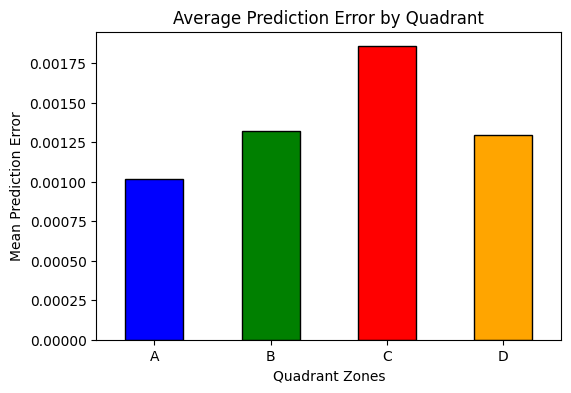

In [ ]:
#Load test data and predictions
y_test = np.load(drive_path + "/y_test.npy")
y_pred = np.load(drive_path + "/y_pred.npy")

#Define Porto city quadrants based on lat/lon ranges
mid_lat = np.median(y_test[:, 0])  # Median latitude
mid_lon = np.median(y_test[:, 1])  # Median longitude

#Compute errors (Euclidean distance between actual and predicted points)
errors = np.sqrt((y_test[:, 0] - y_pred[:, 0])**2 + (y_test[:, 1] - y_pred[:, 1])**2)

#Assign Quadrants: A (Upper Left), B (Upper Right), C (Lower Left), D (Lower Right)
zones = []
for lat, lon in zip(y_test[:, 0], y_test[:, 1]):
    if lat >= mid_lat and lon < mid_lon:
        zones.append("A")
    elif lat >= mid_lat and lon >= mid_lon:
        zones.append("B")
    elif lat < mid_lat and lon < mid_lon:
        zones.append("C")
    else:
        zones.append("D")

#Convert to DataFrame for analysis
df = pd.DataFrame({"Latitude": y_test[:, 0], "Longitude": y_test[:, 1], "Error": errors, "Zone": zones})

#Aggregate mean error per quadrant
zone_errors = df.groupby("Zone")["Error"].mean().reindex(["A", "B", "C", "D"])

#Plot error heatmap per quadrant
plt.figure(figsize=(6, 4))
zone_errors.plot(kind="bar", color=["blue", "green", "red", "orange"], edgecolor="black")
plt.xlabel("Quadrant Zones")
plt.ylabel("Mean Prediction Error")
plt.title("Average Prediction Error by Quadrant")
plt.xticks(rotation=0)
plt.show()


In [ ]:
# load the kmeans model
kmeans = joblib.load(drive_path + "zone.pkl")

def find_zone(latitude, longitude, kmeans):
    """Returns the zone for a given latitude and longitude."""
    coords = np.array([[latitude, longitude]])
    zone = kmeans.predict(coords)[0]  # Predict the zone
    return zone

In [ ]:
# save the actual preducted values in csv along along with orignal taxi id and timestamps in df
# Load Original Indices
original_indices = np.load(drive_path + "/seq_indices.npy")

# Get the relevant columns (taxi_id and timestamp) from the original DataFrame using original indices
taxi_ids = df.loc[X_test_indices , 'TAXI_ID'].values
timestamps = df.loc[X_test_indices , 'TIMESTAMP'].values

y_test_unscaled = scaler.inverse_transform(y_test)
y_pred_unscaled = scaler.inverse_transform(y_pred)


print(taxi_ids.shape,timestamps.shape, y_test.shape, y_pred.shape)
# Create a new DataFrame
results_df = pd.DataFrame({
    'taxi_id': taxi_ids,
    'timestamp': timestamps,
    'actual_x': y_test_unscaled[:, 0],  # Assuming y_test is [x, y] coordinates
    'actual_y': y_test_unscaled[:, 1],
    'predicted_x': y_pred_unscaled[:, 0],  # Predicted x coordinate
    'predicted_y': y_pred_unscaled[:, 1]   # Predicted y coordinate
})

results_df['actual_zone'] = results_df.apply(lambda x: 'zone ' + str(find_zone(x['actual_x'], x['actual_y'], kmeans) + 1), axis=1)
results_df['predicted_zone'] = results_df.apply(lambda x: 'zone ' + str(find_zone(x['predicted_x'], x['predicted_y'], kmeans) + 1), axis=1)

# Display the results
print(results_df.head())

results_df.to_csv(drive_path + "/next_location_results.csv", index=False)


(40000,) (40000,) (40000, 2) (40000, 2)


/Users/bosky/boskymsaiicoursework/src/module2-assginment/lib/python3.12/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(
/Users/bosky/boskymsaiicoursework/src/module2-assginment/lib/python3.12/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(
/Users/bosky/boskymsaiicoursework/src/module2-assginment/lib/python3.12/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(
/Users/bosky/boskymsaiicoursework/src/module2-assginment/lib/python3.12/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(
/Users/bosky/boskymsaiicoursework/src/module2-assginment/lib/python3.12/site-packages/sk

    taxi_id           timestamp  actual_x   actual_y  predicted_x  \
0  20000235 2014-01-26 03:25:04 -8.622882  41.169258    -8.673358   
1  20000013 2014-03-22 20:00:25 -8.644995  41.150448    -8.680100   
2  20000507 2013-08-25 15:06:28 -8.587512  41.149269    -8.640457   
3  20000312 2013-09-06 08:28:01 -8.648604  41.172471    -8.685811   
4  20000031 2014-03-15 07:40:50 -8.660538  41.194287    -8.693919   

   predicted_y actual_zone predicted_zone  
0    41.170029      zone 5         zone 2  
1    41.156124      zone 5         zone 2  
2    41.147942      zone 3         zone 5  
3    41.168564      zone 5         zone 2  
4    41.199215      zone 2         zone 2  
